# Assignment 4

**Course:** Introdução ao Processamento Digital de Imagem (MO443)  
**Goal:** To study texture descriptors and their applications in Computer Vision  
**Author:** Lucas Oliveira David, 188972 --- <lucas.david@ic.unicamp.br>

In [1]:
import seaborn as sns

class Config:
    class data:
        path = '/content/drive/MyDrive/datasets/MO443/textures'
        samples = 512

    class lbp:
      r = 1
      p = 8
      method = 'default'

    colors = sns.color_palette("Set3")
    seed = 2378

## Setup

In [2]:
from math import ceil
from functools import partial as ftpartial

import numpy as np
import pandas as pd

import matplotlib.pyplot as plt

import os
import skimage.io
import skimage.filters
import skimage.feature
import skimage.segmentation
from skimage.measure import regionprops_table

from skimage.color import label2rgb

In [3]:
sns.set()

def partial(func, *args, **kwargs):
    partial_func = ftpartial(func, *args, **kwargs)
    partial_func.__name__ = (f"{func.__name__} {' '.join(map(str, args))}"
                             f" {' '.join((f'{a}={b}' for a, b in kwargs.items()))}")
    return partial_func

def visualize(
    image,
    title=None,
    rows=2,
    cols=None,
    cmap=None,
    figsize=(12, 6)
):
    if image is not None:
        cols = cols or ceil(len(image) / rows)

        if isinstance(image, (list, tuple)) or len(image.shape) > 3:  # many images
            fig = plt.figure(figsize=figsize)
            for ix in range(len(image)):
                plt.subplot(rows, cols, ix+1)
                visualize(image[ix],
                          cmap=cmap,
                          title=title[ix] if title is not None and len(title) > ix else None,
                          rows=rows,
                          cols=cols)
            plt.tight_layout()
            return fig

        if image.shape[-1] == 1: image = image[..., 0]
        plt.imshow(image, cmap=cmap)
    
    if title is not None: plt.title(title)
    plt.axis('off')

## Datasets

### Textures

In [4]:
simple_image_files = sorted(os.listdir(Config.data.path))
simple_images = [skimage.io.imread(os.path.join(Config.data.path, f)) for f in simple_image_files]
simple_grays = [skimage.color.rgb2gray(i) for i in simple_images]
simple_classes = simple_image_files

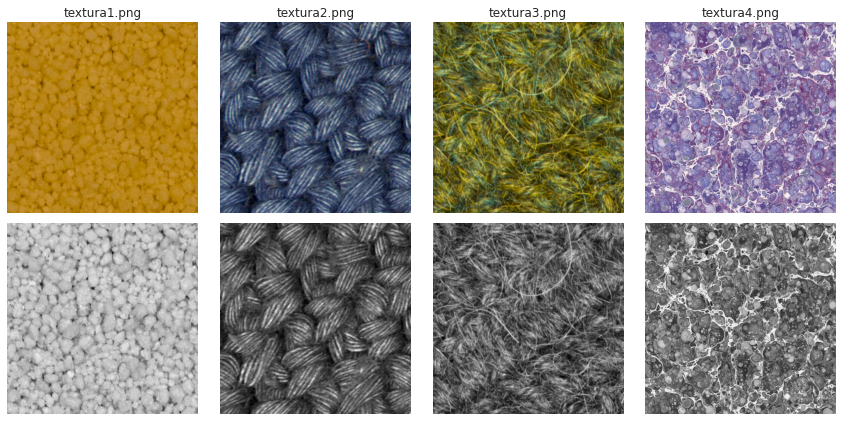

In [5]:
#@title

visualize([*simple_images, *simple_grays], simple_classes, cmap='gray', figsize=(12, 6));

### DTD

In [6]:
ALLOWED_CLASSES = 'honeycombed cracked polka-dotted wrinkled'.split()

In [ ]:
#@title

import tensorflow as tf
import tensorflow_datasets as tfds

(train,), info = tfds.load('dtd', split=['train'], with_info=True, shuffle_files=False)

int2str = info.features['label'].int2str

allowed_labels = tf.constant([info.features['label'].str2int(c)
                              for c in ALLOWED_CLASSES])

@tf.function
def only_allowed_labels_predicate(x):
    label = x['label']
    isallowed = tf.equal(allowed_labels, tf.cast(label, allowed_labels.dtype))
    reduced = tf.reduce_sum(tf.cast(isallowed, tf.float32))
    return tf.greater(reduced, tf.constant(0.))


dtd_samples = list(
    train.filter(only_allowed_labels_predicate)
         .take(Config.data.samples))

dtd_images = [s['image'].numpy() for s in dtd_samples]
dtd_grays = [skimage.color.rgb2gray(i) for i in dtd_images]

dtd_labels = [s['label'].numpy() for s in dtd_samples]
dtd_classes = [int2str(l) for l in dtd_labels]

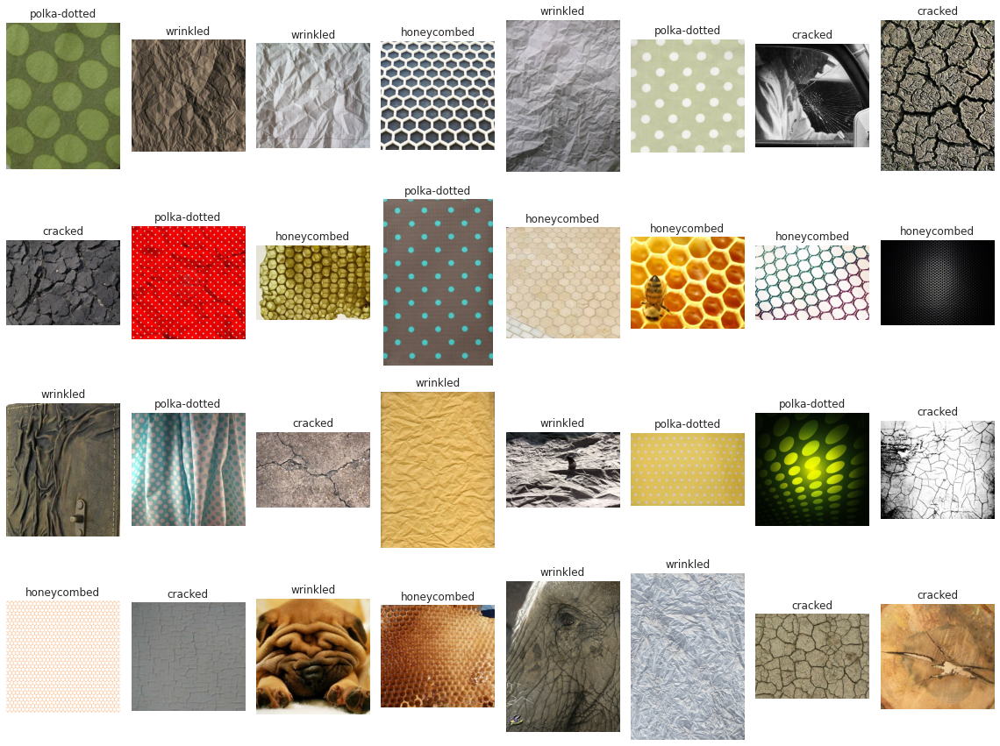

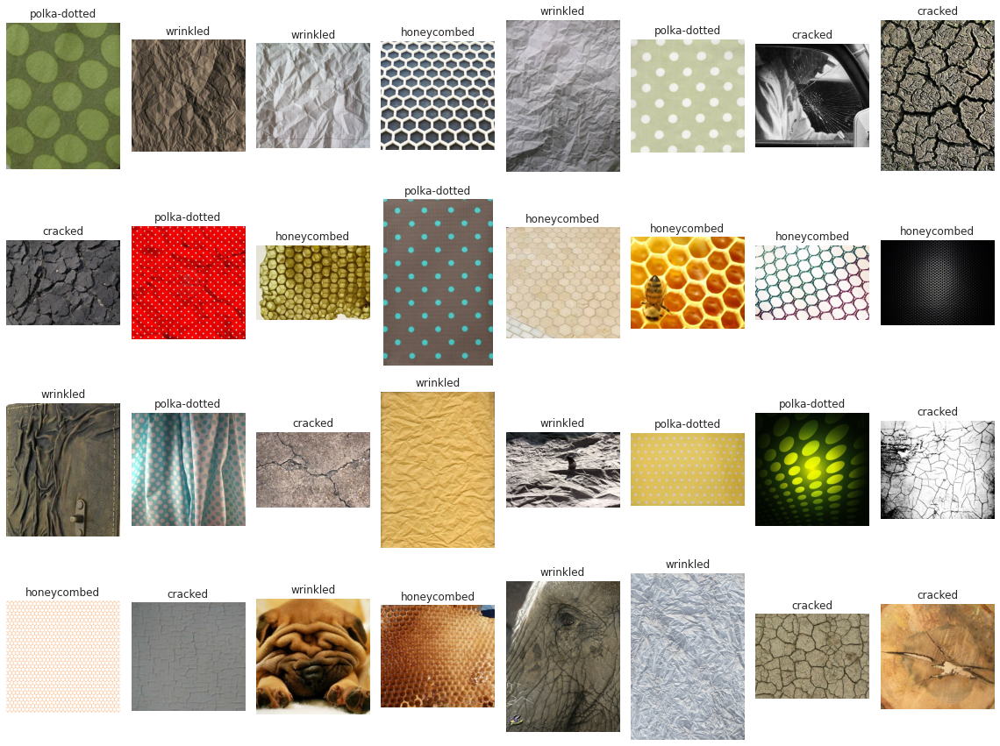

In [8]:
#@title

visualize(image=[s['image'] for s in dtd_samples[:32]],
          title=dtd_classes,
          rows=4,
          figsize=(16, 12))

## Distance Functions

In [9]:
def kullback_leibler_divergence(p, q):
    p = np.asarray(p)
    q = np.asarray(q)
    filt = np.logical_and(p != 0, q != 0)
    return np.sum(p[filt] * np.log2(p[filt] / q[filt]))

def bhattacharyya(a, b):
    """ Bhattacharyya distance between distributions (lists of floats).

    :ref: https://gist.github.com/miku/1671b2014b003ee7b9054c0618c805f7
    """
    return -np.log(np.sqrt(a*b).sum())

## Local Binary Pattern for Texture Images

In [10]:
from skimage import feature

inputs = simple_grays
Rs = np.asarray([1, 1, 2, 2, 3, 3])
Ps = np.asarray([4, 8, 4, 8, 4, 8])

In [11]:
lbps = [[feature.local_binary_pattern(g, p, r, Config.lbp.method) for r, p in zip(Rs, Ps)]
        for g in inputs]

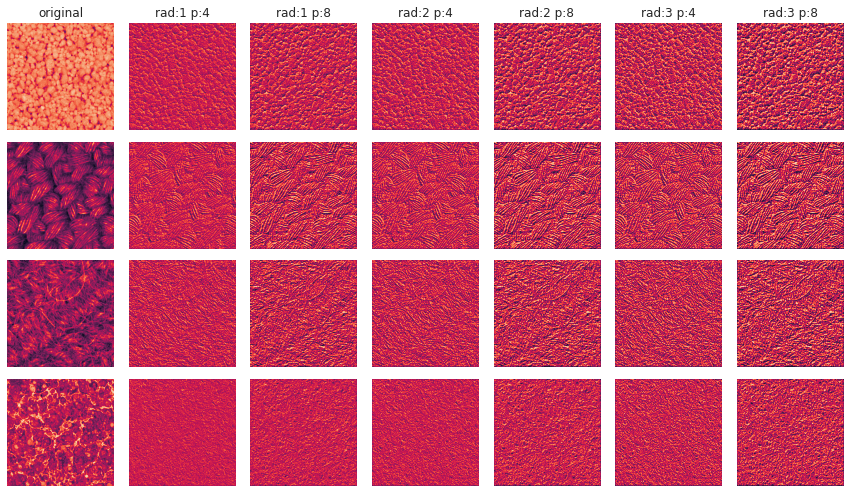

In [12]:
#@title Effect of `radius` over LBP

visualize(sum([[a, *b] for a, b in zip(inputs, lbps)], []),
          ['original', *(f'rad:{r} p:{p}' for r, p in zip(Rs, Ps))],
          rows=len(inputs),
          figsize=(12, 1.75*len(inputs)));

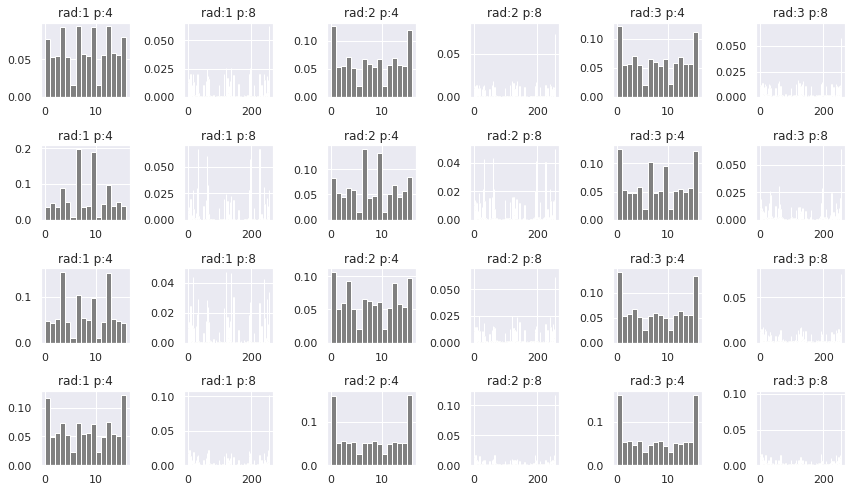

In [13]:
#@title Effect of `radius` over LBP's histograms

plt.figure(figsize=(12, 1.75*len(inputs)))

def plot_histogram(lbp):
    n_bins = int(lbp.max() + 1)
    return plt.hist(lbp.ravel(), density=True, bins=n_bins, range=(0, n_bins), facecolor='0.5')

def plot_histograms_for_all():
  for ix, (i, lbp_i) in enumerate(zip(inputs, lbps)):
    for jx, (r, p, l) in enumerate(zip(Rs, Ps, lbp_i)):
      plt.subplot(len(inputs), len(Rs), ix*len(Rs) + jx + 1)
      plt.title(f'rad:{r} p:{p}')
      plot_histogram(l)
  plt.tight_layout()

plot_histograms_for_all()

### Comparing Texture Images

In [14]:
inputs = dtd_grays
classes = dtd_classes

In [15]:
from skimage import feature


lbps = [feature.local_binary_pattern(g,
                                     P=Config.lbp.p,
                                     R=Config.lbp.r,
                                     method=Config.lbp.method)
        for g in inputs]

In [16]:
bins = np.asarray([int(l.max()+1) for l in lbps])

# for ix, (i, b) in enumerate(zip(inputs[:4], bins)):
#   print('Image {ix}')
#   print('  shape:', i.shape)
#   print('  bins: ', b)

In [17]:
hists = [np.histogram(l, density=True, bins=b, range=(0, b))[0]
         for l, b in zip(lbps, bins)]

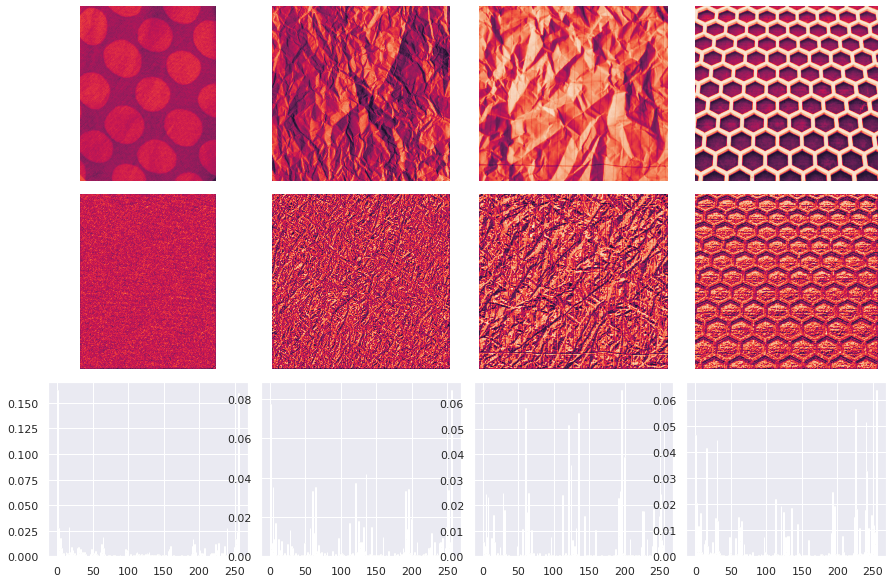

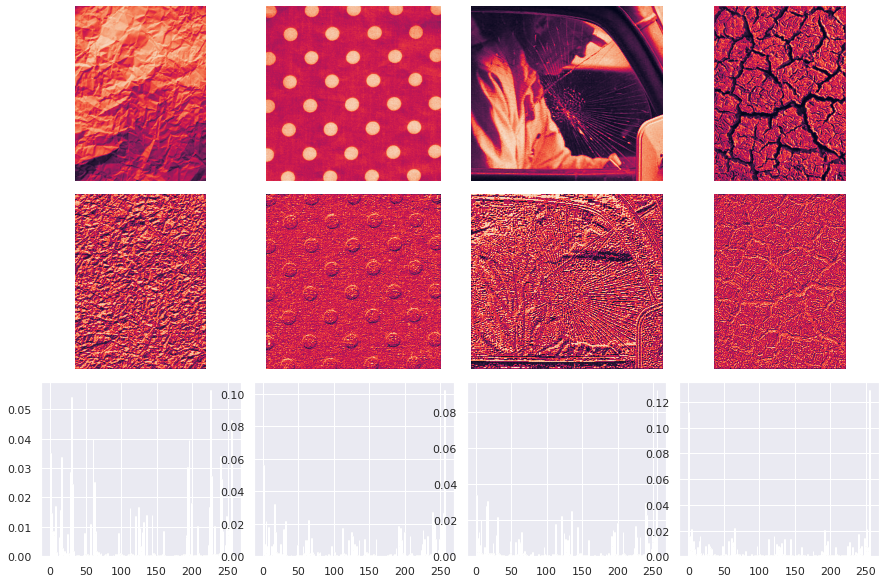

In [19]:
#@title

N = 2

for ix in range(N):
  inputs_ix = inputs[ix*4:(ix+1)*4]
  lbps_ix = lbps[ix*4:(ix+1)*4]

  visualize([*inputs_ix, *lbps_ix], figsize=(12, 8),
            cols=len(inputs_ix),
            rows=3)

  def plot_histograms(ix):
    for ix, l in enumerate(lbps_ix):
      plt.subplot(3, len(inputs_ix), 2*len(inputs_ix)+ix+1)
      plot_histogram(l)

  plot_histograms(ix)

In [20]:
from scipy.spatial.distance import cdist

dh = cdist(hists, hists, metric=kullback_leibler_divergence)

# braycurtis canberra chebyshev cityblock correlation cosine dice euclidean 
# hamming jaccard jensenshannon kulsinski mahalanobis matching minkowski 
# rogerstanimoto russellrao seuclidean sokalmichener sokalsneath sqeuclidean 
# wminkowski yule

In [35]:
#@title


def plot_similarity_matrix(dst, classes, normed=False, annot=False):
  labels = np.asarray(classes)
  s = np.argsort(labels)
  d = dst[s][:, s]
  labels = labels[s]

  d_normed = d-d.min(axis=0, keepdims=True)
  d_normed /= d.max(axis=0, keepdims=True)

  if normed:
    if annot:
      annot = d
    d = d_normed
  
  mask = np.tril(d) <= 0

  with sns.axes_style("white"):
    plt.figure(figsize=(12, 8))
    sns.heatmap(d, annot=annot, cmap="RdPu_r", cbar=False, annot_kws={'size': 8},
                xticklabels=labels, yticklabels=labels, mask=mask)
    plt.tight_layout();

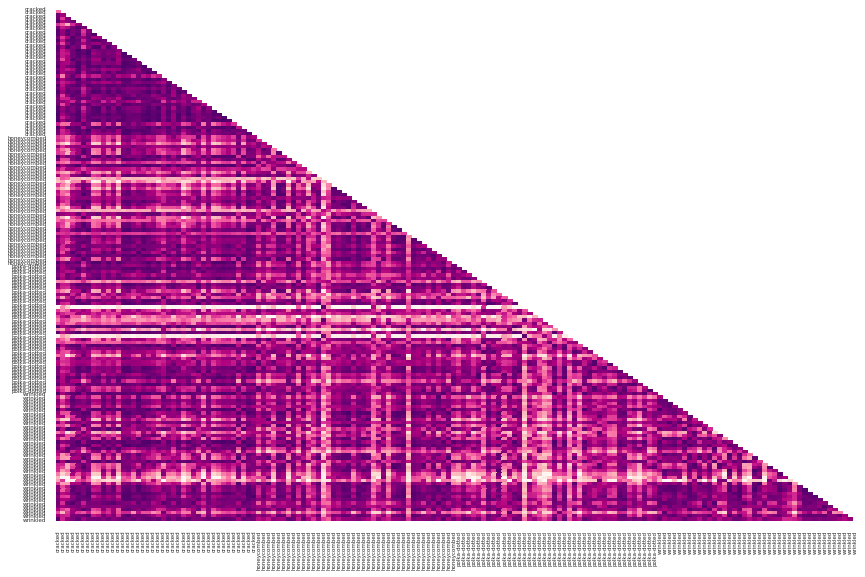

In [36]:
sns.set(font_scale=0.5)
plot_similarity_matrix(dh, classes, normed=True)

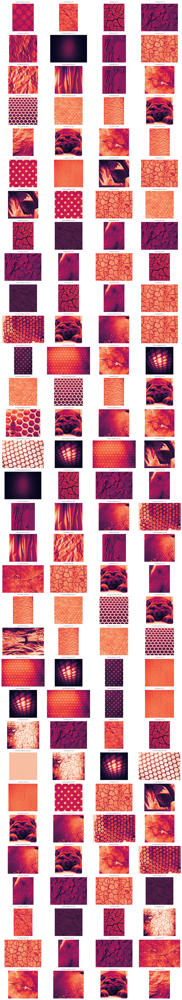

In [37]:
#@title

def plot_most_similar(images, classes, dst):
  similarity_index = np.argsort(dst, axis=1)[:, 1:4]
  ds = np.take_along_axis(dst, similarity_index, axis=1)

  vis = sum([[i] + [images[j] for j in s]
             for i, s in zip(images, similarity_index)], [])

  titles = sum([[f'{anchor_label} (anchor)'] +
                [f'{classes[ix]} d:{d:.2f}' for ix, d in zip(ii, di)]
                for ii, di, anchor_label in zip(similarity_index, ds, classes)
               ], [])

  visualize(vis,
            titles,
            rows=len(images), figsize=(12, 2*len(images)))

plot_most_similar(inputs[:32], classes[:32], dh[:32, :32])

## Gray Level Co-occurrence Matrix Texture Features

### Comparing Texture Images

In [30]:
inputs = dtd_grays
classes = dtd_classes

# props = ('contrast', 'dissimilarity', 'homogeneity', 'energy', 'correlation', 'ASM')
distances = [1, 2, 3, 4]
angles = [0, np.pi/4, np.pi/2, 3*np.pi/4]
props = ('dissimilarity', 'correlation')

In [31]:
from skimage.feature import greycomatrix, greycoprops

def to_uint8(x):
  return (x*255).astype('uint8')

def glcm_features(x):
  co = greycomatrix(
    to_uint8(x),
    distances=distances,
    angles=angles,
    levels=256,
    symmetric=True,
    normed=True
  )

  return np.asarray([greycoprops(co, prop=p)
                     for p in props]).ravel()

In [32]:
features = np.asarray([glcm_features(x) for x in inputs])

In [33]:
print('Examples:')
features.astype(int)[:5, :5]

Examples:


array([[31, 36, 33, 27, 38],
       [16, 16, 10, 17, 22],
       [ 6,  7,  3,  7, 11],
       [ 6, 10,  8, 10, 12],
       [ 4,  7,  5,  5,  7]])

In [34]:
dco = cdist(features, features, metric='cosine')

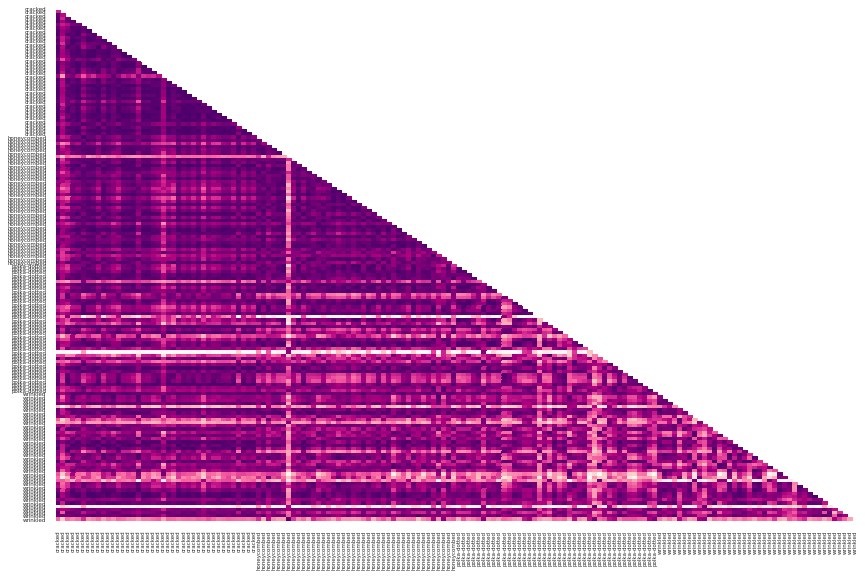

In [38]:
sns.set(font_scale=0.5)
plot_similarity_matrix(dco, classes, normed=True)

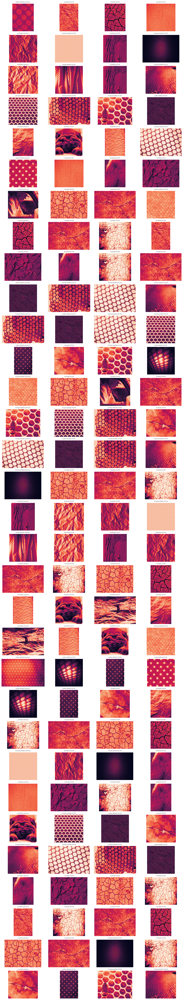

In [39]:
plot_most_similar(inputs[:32], classes[:32], dco[:32, :32])

## Evaluation

In [40]:
def top_k_score(classes, dst, top=1):
  classes = np.asarray(classes)
  matches = classes[np.argsort(dst, axis=1)[:, 1:1+top]]
  corrects = classes.reshape(-1, 1) == matches
  
  return (corrects.any(axis=1)).mean()

In [41]:
print('LBP')
print('    acc score:', top_k_score(classes, dh, top=1))
print('  top-3 score:', top_k_score(classes, dh, top=3))
print('  top-5 score:', top_k_score(classes, dh, top=5))

print('GLCM')
print('    acc score:', top_k_score(classes, dco, top=1))
print('  top-3 score:', top_k_score(classes, dco, top=3))
print('  top-5 score:', top_k_score(classes, dco, top=5))

LBP
    acc score: 0.46875
  top-3 score: 0.74375
  top-5 score: 0.84375
GLCM
    acc score: 0.44375
  top-3 score: 0.7625
  top-5 score: 0.85
